In [1]:
%matplotlib inline


家具DCGAN
==============

**Author**: Eitaro Yamatsuta <https://github.com/eitarox>




In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


Inputs
------
- 画像サイズは64x64. 他のサイズにする場合はD,Gの変更が必要
   [参考](https://github.com/pytorch/examples/issues/70)

In [16]:
# Root directory for dataset
dataroot = "data/furniture"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 800

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

データセット準備
----
家具の写真（https://www.kaggle.com/akkithetechie/furniture-detector）　　
ファイル構成は下記の通り
   /path/to/furniture
       -> chair
           -> 000001.jpg
           -> 000002.jpg
           -> 000003.jpg
           -> 000004.jpg
              ...
       -> bed
           ->
              ...

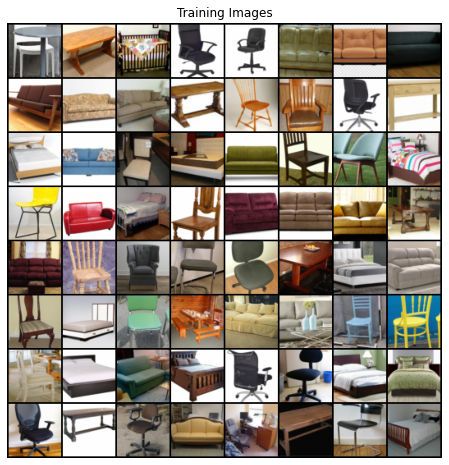

In [17]:
# ImageFolderを使用
# https://pytorch.org/docs/stable/torchvision/datasets.html#imagefolder
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

初期化

In [18]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator(生成器)

In [19]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

Generatorのインスタンスに初期weightを代入

In [20]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


Discriminator（識別器）

In [21]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Discriminatorのインスタンスを生成し、初期weightを代入。モデル構造を確認。

In [22]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


Loss Functions and Optimizers（損失関数と最適化アルゴリズム）

In [23]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

Training（訓練）
1. Train the Discriminator 識別器を訓練する
2. Train the Generator** 生成期を訓練する

この処理には時間がかかります。

In [24]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

Starting Training Loop...
[0/800][0/35]	Loss_D: 1.6833	Loss_G: 2.9434	D(x): 0.3766	D(G(z)): 0.3135 / 0.0658
[1/800][0/35]	Loss_D: 1.6807	Loss_G: 19.2243	D(x): 0.9579	D(G(z)): 0.7610 / 0.0000
[2/800][0/35]	Loss_D: 0.0332	Loss_G: 15.5203	D(x): 0.9706	D(G(z)): 0.0000 / 0.0000
[3/800][0/35]	Loss_D: 0.1078	Loss_G: 4.3710	D(x): 0.9466	D(G(z)): 0.0398 / 0.0185
[4/800][0/35]	Loss_D: 0.4301	Loss_G: 5.1846	D(x): 0.8885	D(G(z)): 0.2246 / 0.0089
[5/800][0/35]	Loss_D: 0.6666	Loss_G: 2.5260	D(x): 0.7031	D(G(z)): 0.2140 / 0.1008
[6/800][0/35]	Loss_D: 0.6042	Loss_G: 5.0944	D(x): 0.8612	D(G(z)): 0.3297 / 0.0103
[7/800][0/35]	Loss_D: 0.2428	Loss_G: 4.6630	D(x): 0.9441	D(G(z)): 0.1637 / 0.0116
[8/800][0/35]	Loss_D: 0.4981	Loss_G: 3.5582	D(x): 0.7117	D(G(z)): 0.0408 / 0.0394
[9/800][0/35]	Loss_D: 0.2597	Loss_G: 3.8396	D(x): 0.8554	D(G(z)): 0.0663 / 0.0357
[10/800][0/35]	Loss_D: 0.6397	Loss_G: 3.2994	D(x): 0.7392	D(G(z)): 0.1889 / 0.0629
[11/800][0/35]	Loss_D: 0.2917	Loss_G: 4.7381	D(x): 0.9166	D(G(z)): 0.

[99/800][0/35]	Loss_D: 0.9180	Loss_G: 6.9013	D(x): 0.9921	D(G(z)): 0.5054 / 0.0044
[100/800][0/35]	Loss_D: 0.2165	Loss_G: 4.1486	D(x): 0.9591	D(G(z)): 0.1480 / 0.0254
[101/800][0/35]	Loss_D: 0.4159	Loss_G: 5.6629	D(x): 0.9792	D(G(z)): 0.2923 / 0.0079
[102/800][0/35]	Loss_D: 0.1557	Loss_G: 3.1727	D(x): 0.8978	D(G(z)): 0.0421 / 0.0589
[103/800][0/35]	Loss_D: 0.1417	Loss_G: 4.1968	D(x): 0.9701	D(G(z)): 0.1008 / 0.0211
[104/800][0/35]	Loss_D: 0.2078	Loss_G: 4.9889	D(x): 0.9646	D(G(z)): 0.1404 / 0.0119
[105/800][0/35]	Loss_D: 1.7152	Loss_G: 0.9850	D(x): 0.2956	D(G(z)): 0.0076 / 0.5209
[106/800][0/35]	Loss_D: 0.2215	Loss_G: 3.3493	D(x): 0.9065	D(G(z)): 0.1062 / 0.0501
[107/800][0/35]	Loss_D: 0.1525	Loss_G: 3.9873	D(x): 0.9683	D(G(z)): 0.1045 / 0.0278
[108/800][0/35]	Loss_D: 0.1095	Loss_G: 4.3150	D(x): 0.9476	D(G(z)): 0.0513 / 0.0229
[109/800][0/35]	Loss_D: 0.5456	Loss_G: 3.6522	D(x): 0.8434	D(G(z)): 0.2384 / 0.0481
[110/800][0/35]	Loss_D: 0.2357	Loss_G: 3.3875	D(x): 0.9006	D(G(z)): 0.1078 / 

[197/800][0/35]	Loss_D: 0.0613	Loss_G: 4.7431	D(x): 0.9665	D(G(z)): 0.0257 / 0.0156
[198/800][0/35]	Loss_D: 0.0927	Loss_G: 4.5048	D(x): 0.9740	D(G(z)): 0.0620 / 0.0162
[199/800][0/35]	Loss_D: 0.0738	Loss_G: 4.2267	D(x): 0.9585	D(G(z)): 0.0295 / 0.0267
[200/800][0/35]	Loss_D: 0.0837	Loss_G: 4.3711	D(x): 0.9409	D(G(z)): 0.0207 / 0.0263
[201/800][0/35]	Loss_D: 0.0806	Loss_G: 4.6192	D(x): 0.9687	D(G(z)): 0.0448 / 0.0176
[202/800][0/35]	Loss_D: 0.0681	Loss_G: 4.1726	D(x): 0.9616	D(G(z)): 0.0270 / 0.0281
[203/800][0/35]	Loss_D: 0.0662	Loss_G: 4.7710	D(x): 0.9770	D(G(z)): 0.0401 / 0.0143
[204/800][0/35]	Loss_D: 0.0732	Loss_G: 4.2031	D(x): 0.9603	D(G(z)): 0.0309 / 0.0262
[205/800][0/35]	Loss_D: 0.0484	Loss_G: 4.7427	D(x): 0.9694	D(G(z)): 0.0167 / 0.0162
[206/800][0/35]	Loss_D: 0.3287	Loss_G: 8.3873	D(x): 0.9919	D(G(z)): 0.2415 / 0.0008
[207/800][0/35]	Loss_D: 0.9898	Loss_G: 2.7354	D(x): 0.6114	D(G(z)): 0.2227 / 0.1697
[208/800][0/35]	Loss_D: 1.0195	Loss_G: 7.4401	D(x): 0.9788	D(G(z)): 0.5175 /

[295/800][0/35]	Loss_D: 1.0972	Loss_G: 1.7369	D(x): 0.5207	D(G(z)): 0.0924 / 0.3185
[296/800][0/35]	Loss_D: 0.3667	Loss_G: 4.9149	D(x): 0.9326	D(G(z)): 0.1993 / 0.0187
[297/800][0/35]	Loss_D: 0.2758	Loss_G: 5.2604	D(x): 0.9709	D(G(z)): 0.1797 / 0.0133
[298/800][0/35]	Loss_D: 0.8103	Loss_G: 2.7177	D(x): 0.7011	D(G(z)): 0.2222 / 0.1324
[299/800][0/35]	Loss_D: 0.1639	Loss_G: 4.3046	D(x): 0.9031	D(G(z)): 0.0456 / 0.0366
[300/800][0/35]	Loss_D: 0.0821	Loss_G: 4.8563	D(x): 0.9594	D(G(z)): 0.0361 / 0.0148
[301/800][0/35]	Loss_D: 0.0652	Loss_G: 4.6336	D(x): 0.9558	D(G(z)): 0.0187 / 0.0214
[302/800][0/35]	Loss_D: 0.0744	Loss_G: 4.5279	D(x): 0.9522	D(G(z)): 0.0235 / 0.0226
[303/800][0/35]	Loss_D: 0.0668	Loss_G: 4.2424	D(x): 0.9607	D(G(z)): 0.0251 / 0.0258
[304/800][0/35]	Loss_D: 0.0555	Loss_G: 4.8415	D(x): 0.9727	D(G(z)): 0.0263 / 0.0176
[305/800][0/35]	Loss_D: 0.0663	Loss_G: 5.7756	D(x): 0.9925	D(G(z)): 0.0532 / 0.0059
[306/800][0/35]	Loss_D: 0.0499	Loss_G: 5.1245	D(x): 0.9827	D(G(z)): 0.0307 /

[393/800][0/35]	Loss_D: 0.3556	Loss_G: 3.5951	D(x): 0.8141	D(G(z)): 0.0809 / 0.1011
[394/800][0/35]	Loss_D: 0.2837	Loss_G: 3.9758	D(x): 0.8804	D(G(z)): 0.1010 / 0.0526
[395/800][0/35]	Loss_D: 0.1052	Loss_G: 5.6479	D(x): 0.9895	D(G(z)): 0.0808 / 0.0068
[396/800][0/35]	Loss_D: 0.0282	Loss_G: 6.0162	D(x): 0.9874	D(G(z)): 0.0150 / 0.0070
[397/800][0/35]	Loss_D: 0.0347	Loss_G: 5.3080	D(x): 0.9919	D(G(z)): 0.0251 / 0.0109
[398/800][0/35]	Loss_D: 0.0386	Loss_G: 5.5298	D(x): 0.9918	D(G(z)): 0.0287 / 0.0089
[399/800][0/35]	Loss_D: 0.0233	Loss_G: 5.7066	D(x): 0.9885	D(G(z)): 0.0114 / 0.0079
[400/800][0/35]	Loss_D: 0.0266	Loss_G: 5.5084	D(x): 0.9850	D(G(z)): 0.0111 / 0.0083
[401/800][0/35]	Loss_D: 0.0262	Loss_G: 5.5420	D(x): 0.9937	D(G(z)): 0.0193 / 0.0100
[402/800][0/35]	Loss_D: 0.0244	Loss_G: 5.8440	D(x): 0.9896	D(G(z)): 0.0136 / 0.0072
[403/800][0/35]	Loss_D: 0.0269	Loss_G: 5.6224	D(x): 0.9909	D(G(z)): 0.0170 / 0.0078
[404/800][0/35]	Loss_D: 0.0237	Loss_G: 5.8765	D(x): 0.9864	D(G(z)): 0.0098 /

[491/800][0/35]	Loss_D: 0.0734	Loss_G: 5.6883	D(x): 0.9511	D(G(z)): 0.0186 / 0.0107
[492/800][0/35]	Loss_D: 0.0357	Loss_G: 5.5282	D(x): 0.9842	D(G(z)): 0.0188 / 0.0112
[493/800][0/35]	Loss_D: 0.0478	Loss_G: 5.8236	D(x): 0.9765	D(G(z)): 0.0211 / 0.0087
[494/800][0/35]	Loss_D: 0.0301	Loss_G: 5.8195	D(x): 0.9801	D(G(z)): 0.0095 / 0.0092
[495/800][0/35]	Loss_D: 0.0314	Loss_G: 6.0232	D(x): 0.9865	D(G(z)): 0.0172 / 0.0063
[496/800][0/35]	Loss_D: 0.0282	Loss_G: 6.0933	D(x): 0.9922	D(G(z)): 0.0183 / 0.0060
[497/800][0/35]	Loss_D: 0.0219	Loss_G: 6.1174	D(x): 0.9878	D(G(z)): 0.0093 / 0.0061
[498/800][0/35]	Loss_D: 0.0173	Loss_G: 6.1303	D(x): 0.9962	D(G(z)): 0.0131 / 0.0060
[499/800][0/35]	Loss_D: 0.0292	Loss_G: 5.9520	D(x): 0.9833	D(G(z)): 0.0114 / 0.0075
[500/800][0/35]	Loss_D: 0.0220	Loss_G: 6.2496	D(x): 0.9904	D(G(z)): 0.0119 / 0.0051
[501/800][0/35]	Loss_D: 0.0160	Loss_G: 5.8343	D(x): 0.9963	D(G(z)): 0.0120 / 0.0059
[502/800][0/35]	Loss_D: 0.0133	Loss_G: 6.5404	D(x): 0.9932	D(G(z)): 0.0064 /

[589/800][0/35]	Loss_D: 0.0082	Loss_G: 6.5534	D(x): 0.9949	D(G(z)): 0.0031 / 0.0039
[590/800][0/35]	Loss_D: 0.0112	Loss_G: 7.5507	D(x): 0.9979	D(G(z)): 0.0086 / 0.0015
[591/800][0/35]	Loss_D: 0.0093	Loss_G: 7.3792	D(x): 0.9982	D(G(z)): 0.0073 / 0.0021
[592/800][0/35]	Loss_D: 0.0107	Loss_G: 7.1122	D(x): 0.9989	D(G(z)): 0.0093 / 0.0020
[593/800][0/35]	Loss_D: 0.0056	Loss_G: 7.4984	D(x): 0.9966	D(G(z)): 0.0022 / 0.0020
[594/800][0/35]	Loss_D: 0.0084	Loss_G: 6.7044	D(x): 0.9975	D(G(z)): 0.0057 / 0.0033
[595/800][0/35]	Loss_D: 0.0076	Loss_G: 7.4753	D(x): 0.9941	D(G(z)): 0.0017 / 0.0024
[596/800][0/35]	Loss_D: 0.0068	Loss_G: 7.1822	D(x): 0.9987	D(G(z)): 0.0054 / 0.0024
[597/800][0/35]	Loss_D: 0.0068	Loss_G: 7.1432	D(x): 0.9988	D(G(z)): 0.0054 / 0.0027
[598/800][0/35]	Loss_D: 0.0043	Loss_G: 7.8231	D(x): 0.9978	D(G(z)): 0.0022 / 0.0014
[599/800][0/35]	Loss_D: 0.0077	Loss_G: 7.5907	D(x): 0.9994	D(G(z)): 0.0069 / 0.0013
[600/800][0/35]	Loss_D: 0.0122	Loss_G: 8.1064	D(x): 0.9993	D(G(z)): 0.0103 /

[687/800][0/35]	Loss_D: 0.0051	Loss_G: 7.3633	D(x): 0.9970	D(G(z)): 0.0022 / 0.0020
[688/800][0/35]	Loss_D: 0.0043	Loss_G: 7.6589	D(x): 0.9995	D(G(z)): 0.0038 / 0.0016
[689/800][0/35]	Loss_D: 0.0075	Loss_G: 8.0185	D(x): 0.9981	D(G(z)): 0.0051 / 0.0013
[690/800][0/35]	Loss_D: 0.0053	Loss_G: 7.6397	D(x): 0.9963	D(G(z)): 0.0016 / 0.0015
[691/800][0/35]	Loss_D: 0.0037	Loss_G: 7.5899	D(x): 0.9980	D(G(z)): 0.0017 / 0.0015
[692/800][0/35]	Loss_D: 0.0048	Loss_G: 7.2125	D(x): 0.9991	D(G(z)): 0.0038 / 0.0022
[693/800][0/35]	Loss_D: 0.0045	Loss_G: 7.7023	D(x): 0.9990	D(G(z)): 0.0035 / 0.0017
[694/800][0/35]	Loss_D: 0.0079	Loss_G: 7.2437	D(x): 0.9993	D(G(z)): 0.0072 / 0.0021
[695/800][0/35]	Loss_D: 0.0035	Loss_G: 7.9855	D(x): 0.9982	D(G(z)): 0.0016 / 0.0011
[696/800][0/35]	Loss_D: 0.0034	Loss_G: 7.4545	D(x): 0.9991	D(G(z)): 0.0026 / 0.0016
[697/800][0/35]	Loss_D: 0.0046	Loss_G: 7.4181	D(x): 0.9974	D(G(z)): 0.0020 / 0.0020
[698/800][0/35]	Loss_D: 0.0051	Loss_G: 7.6793	D(x): 0.9994	D(G(z)): 0.0044 /

[785/800][0/35]	Loss_D: 0.0083	Loss_G: 7.0574	D(x): 0.9948	D(G(z)): 0.0031 / 0.0028
[786/800][0/35]	Loss_D: 0.0130	Loss_G: 7.0003	D(x): 0.9970	D(G(z)): 0.0096 / 0.0029
[787/800][0/35]	Loss_D: 0.0095	Loss_G: 7.1411	D(x): 0.9986	D(G(z)): 0.0079 / 0.0028
[788/800][0/35]	Loss_D: 0.0081	Loss_G: 7.0143	D(x): 0.9984	D(G(z)): 0.0064 / 0.0031
[789/800][0/35]	Loss_D: 0.0093	Loss_G: 7.1401	D(x): 0.9929	D(G(z)): 0.0022 / 0.0028
[790/800][0/35]	Loss_D: 0.0131	Loss_G: 6.7991	D(x): 0.9919	D(G(z)): 0.0049 / 0.0039
[791/800][0/35]	Loss_D: 0.0111	Loss_G: 7.5496	D(x): 0.9909	D(G(z)): 0.0019 / 0.0028
[792/800][0/35]	Loss_D: 0.0035	Loss_G: 7.8517	D(x): 0.9987	D(G(z)): 0.0022 / 0.0016
[793/800][0/35]	Loss_D: 0.0043	Loss_G: 8.0638	D(x): 0.9972	D(G(z)): 0.0014 / 0.0010
[794/800][0/35]	Loss_D: 0.0050	Loss_G: 7.7682	D(x): 0.9974	D(G(z)): 0.0024 / 0.0016
[795/800][0/35]	Loss_D: 0.0054	Loss_G: 7.6215	D(x): 0.9983	D(G(z)): 0.0037 / 0.0020
[796/800][0/35]	Loss_D: 0.0032	Loss_G: 7.7666	D(x): 0.9990	D(G(z)): 0.0022 /

Results
-------
トレーニング回数に対するDとGの変化

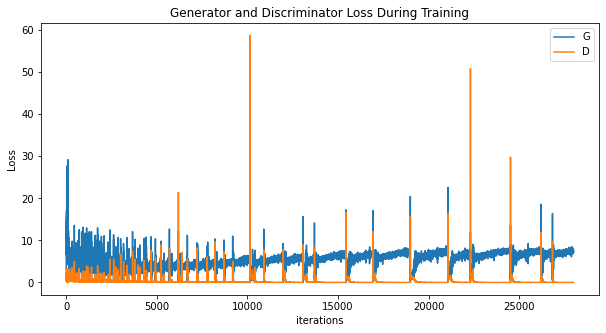

In [25]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

生成期の変化をアニメーションとして出力


Animation size has reached 21217360 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


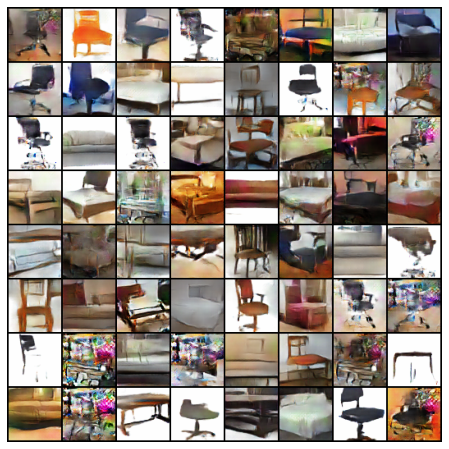

In [26]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save('anim.gif', writer="imagemagick")
ani.save('anim.mp4', writer="ffmpeg")
HTML(ani.to_jshtml())

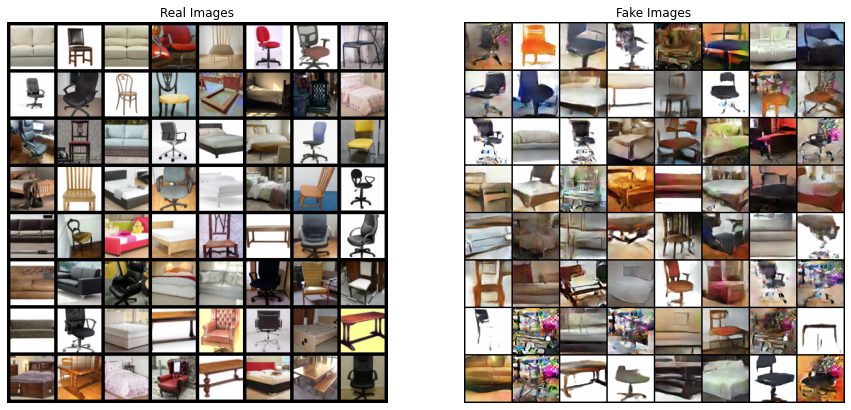

In [27]:
# 元画像とfake画像の比較
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.savefig('Comparison.png')
plt.show()

参考
- [pytorch/examples](https://github.com/pytorch/examples)
- [Unsupervised Representation Learning With Deep Convolutional Generative Adversarial Networks](https://arxiv.org/pdf/1511.06434.pdf)
- [convolution](https://pytorch.org/docs/stable/nn.html#torch.nn.Conv2d)
- [batch norm](https://pytorch.org/docs/stable/nn.html#torch.nn.BatchNorm2d)
- [LeakyReLU](https://pytorch.org/docs/stable/nn.html#torch.nn.LeakyReLU)
- [convolutional-transpose](https://pytorch.org/docs/stable/nn.html#torch.nn.ConvTranspose2d)
- [ReLU](https://pytorch.org/docs/stable/nn.html#relu)


